<h1> Finding Similar Clusters of Suburbs in Melbourne Australia </h1>

<h2> Introduction </h2> 

Melbourne is a popular destination in Australia for immigrants to settle down in and also for locals to move to due to it's vast amount of facilities and ever growing opportunities for career and education. Hence it provides an ideal location for an individual to settle down with a family. 

In this project we aim to use the FourSquare API along with the dataset for melbourne housing prices taken from this [github site](https://raw.githubusercontent.com/nagoya-foundation/r-functions-performance/master/data/Melbourne_housing_FULL.csv). The Foursquare API will be used to find the most popular venue categories in each suburb in the dataset. The dataset of melbourne housing prices will be used to find the average housing price for each suburb. 

Using the number of each venue category in each suburb and the average price of a house of each suburb, we shall find similar suburbs and then correlate them with the average price of a suburb. 

<h2> How this project helps users </h2>

This project serves multiple purposes:

- Allows a user to identify the venue categories in each suburb that they would like to move into. If Price of house isnt a barrier, they may select the suburb with the most appealing characteristics. 
- Allows a user to find which venue categories have the largest impact on the price of a house. 
- Allows users to identify cheaper suburbs with similar sorrounding facilties.
- In the case that a prospective buyer is quoted a High Price, he/she may always refer to this analysis to bargain for a better price as we know the average price of the suburb

Data Used:
- Foursquare API location data
- Housing Price dataset from this [site](https://www.kaggle.com/anthonypino/melbourne-housing-market/version/21)

In [26]:
import pandas as pd
import numpy as np
import json
import folium
import geocoder
import urllib.request,urllib.parse


In [2]:
df = pd.read_csv(r'https://raw.githubusercontent.com/nagoya-foundation/r-functions-performance/master/data/Melbourne_housing_FULL.csv')
df.head()

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,...,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
0,Abbotsford,68 Studley St,2,h,NaN,SS,Jellis,3/09/2016,2.5,3067.0,...,1.0,1.0,126.0,NaN,NaN,Yarra City Council,-37.8014,144.9958,Northern Metropolitan,4019.0
1,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,3067.0,...,1.0,1.0,202.0,NaN,NaN,Yarra City Council,-37.7996,144.9984,Northern Metropolitan,4019.0
2,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.5,3067.0,...,1.0,0.0,156.0,79.0,1900.0,Yarra City Council,-37.8079,144.9934,Northern Metropolitan,4019.0
3,Abbotsford,18/659 Victoria St,3,u,NaN,VB,Rounds,4/02/2016,2.5,3067.0,...,2.0,1.0,0.0,NaN,NaN,Yarra City Council,-37.8114,145.0116,Northern Metropolitan,4019.0
4,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,2.5,3067.0,...,2.0,0.0,134.0,150.0,1900.0,Yarra City Council,-37.8093,144.9944,Northern Metropolitan,4019.0


There are missing values in the Price column. To fill these we will use the mean housing price of each Suburb. 

In [3]:
dfprices = df[['Suburb','Price']].groupby('Suburb').apply(lambda x:x.fillna(x.mean()))

In [4]:
dfprices.reset_index(drop = True, inplace = True)
dfprices.head(10)

,Suburb,Price
0,Abbotsford,1.033549e+06
1,Abbotsford,1.480000e+06
2,Abbotsford,1.035000e+06
3,Abbotsford,1.033549e+06
4,Abbotsford,1.465000e+06
5,Abbotsford,8.500000e+05
6,Abbotsford,1.600000e+06
7,Abbotsford,1.033549e+06
8,Abbotsford,1.033549e+06
9,Abbotsford,1.033549e+06


In [5]:
dfprices.loc[dfprices['Price'].isna()]

,Suburb,Price
2050,Avonsleigh,NaN
3034,Belgrave,NaN
15585,Guys Hill,NaN
17454,Hopetoun Park,NaN
21332,Menzies Creek,NaN
24629,Olinda,NaN


As seen above, we still have some NaN values in our dfprices dataset. However if the instances that these suburbs occur is only once, then we shall drop them from the dataset.

In [6]:
suburb_names = dfprices.loc[dfprices['Price'].isna()]['Suburb'].unique()
numofinstances = list()
for suburb in suburb_names:
    numofinstances.append(df.loc[df['Suburb'] == suburb].shape[0])
  
df_numofinstances = pd.DataFrame(data = {'Suburb':suburb_names,'No. Of Instances':numofinstances})
df_numofinstances

,Suburb,No. Of Instances
0,Avonsleigh,1
1,Belgrave,1
2,Guys Hill,1
3,Hopetoun Park,1
4,Menzies Creek,1
5,Olinda,1


All of the above instances occur only once, hence there is no value to use for the mean house price in these suburbs. Hence these will be dropped from **dfprices**

In [8]:
dfprices.dropna(inplace = True)
dfprices.shape

(34851, 2)

Now that we have filled in the missing prices using the mean price of each suburb, we find the overall mean of each suburb so we can use that data with the Foursquare API to find the sorrounding hotspots.

In [134]:
dfprices_overallmean = dfprices.groupby('Suburb').mean()
dfprices_overallmean.reset_index(inplace = True)
dfprices_overallmean

,Suburb,Price
0,Abbotsford,1.033549e+06
1,Aberfeldie,1.307193e+06
2,Airport West,7.513642e+05
3,Albanvale,5.360556e+05
4,Albert Park,1.927651e+06
5,Albion,6.151237e+05
6,Alphington,1.397532e+06
7,Altona,8.841555e+05
8,Altona Meadows,6.535577e+05
9,Altona North,7.897133e+05


<h3> Obtaining the latitude and longitude of each Suburb using the **Geocoder** Library </h3>

In [20]:
all_suburbs = dfprices_overallmean.index.values.tolist()

In [23]:
latitude = list()
longitude = list()
for suburb in all_suburbs:
    lat_long = None
    while lat_long is None:
        g = geocoder.arcgis('{},Melbourne,Australia'.format(suburb))
        lat_long = g.latlng
    latitude.append(lat_long[0])
    longitude.append(lat_long[1])

In [24]:
latlngdf = pd.DataFrame({'Suburb': all_suburbs , 'Latitude':latitude, 'Longitude':longitude})

In [25]:
latlngdf

,Suburb,Latitude,Longitude
0,Abbotsford,-37.803060,144.997180
1,Aberfeldie,-37.759330,144.895800
2,Airport West,-37.711870,144.886970
3,Albanvale,-37.744600,144.770250
4,Albert Park,-37.844040,144.951260
5,Albion,-37.775560,144.815610
6,Alphington,-37.779420,145.025030
7,Altona,-37.863820,144.824820
8,Altona Meadows,-37.871770,144.777600
9,Altona North,-37.830470,144.841340


In [29]:
overall_latitude = latlngdf['Latitude'].mean()
overall_longitude = latlngdf['Longitude'].mean()

In [30]:
melbourne_map = folium.Map(location = [overall_latitude,overall_longitude], zoom_start = 13)
melbourne_map

In [31]:
for suburb,lat,lng in zip(latlngdf['Suburb'],latlngdf['Latitude'],latlngdf['Longitude']):
    label = suburb
    folium.CircleMarker([lat,lng],radius = 5, popup = label, color = 'blue', fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(melbourne_map)
melbourne_map

<h3> Obtaining the top 50 venues close to any given suburb </h3>

In [67]:
#Foursquare API details
CLIENT_ID = 'DVWJRKZQ20BUTZMTMAVW0355V1C5HQQ2WBFUT2DGW4GKQ5DR' # your Foursquare ID
CLIENT_SECRET = 'VKIQPVI13LA0MFW5ELOK3AVHO1NOYYQTIDW0ARSJWQDOQWIO'
VERSION = '20180605' # Foursquare API version
LIMIT = 50 # A default Foursquare API limit value

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: DVWJRKZQ20BUTZMTMAVW0355V1C5HQQ2WBFUT2DGW4GKQ5DR
CLIENT_SECRET:VKIQPVI13LA0MFW5ELOK3AVHO1NOYYQTIDW0ARSJWQDOQWIO


In [69]:
base_url = 'https://api.foursquare.com/v2/venues/explore?'
parameters = dict()
parameters['client_id'] = CLIENT_ID
parameters['client_secret'] = CLIENT_SECRET
parameters['v'] = VERSION
parameters['radius'] = 500
parameters['limit'] = LIMIT



suburb_list = list()
suburblat = list()
suburblng = list()
venue_list = list()
venuelng_list = list()
venuelat_list = list()
venuecat_list = list()

for suburb,lat,lng in zip(latlngdf['Suburb'],latlngdf['Latitude'],latlngdf['Longitude']):
    parameters['ll'] = '{},{}'.format(lat,lng)
    url = base_url + urllib.parse.urlencode(parameters, safe = ',')
    suburbdata = json.loads(urllib.request.urlopen(url).read())
    
    suburbvenues = suburbdata['response']['groups'][0]['items']
    
    for venue in suburbvenues:
        suburb_list.append(suburb)
        suburblat.append(lat)
        suburblng.append(lng)
        venue_list.append(venue['venue']['name'])
        venuelng_list.append(venue['venue']['location']['lng'])
        venuelat_list.append(venue['venue']['location']['lat'])
        venuecat_list.append(venue['venue']['categories'][0]['name'])
    
nearby_venues = pd.DataFrame({'Suburb':suburb_list,'Suburb Latitude':suburblat,'Suburb Longitude':suburblng,'Venue':venue_list,
                             'Venue Latitude':venuelat_list,'Venue Longitude':venuelng_list,'Venue Category':venuecat_list})

nearby_venues

,Suburb,Suburb Latitude,Suburb Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Abbotsford,-37.803060,144.99718,The Park Hotel,-37.802769,144.997029,Pub
1,Abbotsford,-37.803060,144.99718,Retreat Hotel,-37.801126,144.997548,Pub
2,Abbotsford,-37.803060,144.99718,The Kitchen at Weylandts,-37.805311,144.997345,Café
3,Abbotsford,-37.803060,144.99718,Three Bags Full,-37.807318,144.996603,Café
4,Abbotsford,-37.803060,144.99718,Dr. Morse,-37.799932,144.994113,Gastropub
5,Abbotsford,-37.803060,144.99718,Rita's Cafeteria,-37.799978,144.994047,Pizza Place
6,Abbotsford,-37.803060,144.99718,Mavis the Grocer,-37.803110,144.997020,Convenience Store
7,Abbotsford,-37.803060,144.99718,Laird Hotel,-37.805309,144.993124,Gay Bar
8,Abbotsford,-37.803060,144.99718,Lulie St Tavern,-37.799914,144.994818,Dive Bar
9,Abbotsford,-37.803060,144.99718,The Lactic Factory,-37.801251,144.993406,Rock Climbing Spot


In [211]:
melbourne_onehot = pd.get_dummies(nearby_venues[['Venue Category']],prefix = "",prefix_sep="")
melbourne_onehot['Suburb'] = nearby_venues['Suburb']
columns = [melbourne_onehot.columns.tolist()[-1]] + melbourne_onehot.columns.tolist()[:-1]
melbourne_onehot[columns]
melbourne_onehot

,Adult Boutique,Afghan Restaurant,African Restaurant,Antique Shop,Arcade,Art Gallery,Art Museum,Arts & Crafts Store,Arts & Entertainment,Asian Restaurant,...,Vegetarian / Vegan Restaurant,Video Store,Vietnamese Restaurant,Warehouse Store,Wine Bar,Wine Shop,Wings Joint,Women's Store,Yoga Studio,Suburb
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,Abbotsford
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,Abbotsford
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,Abbotsford
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,Abbotsford
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,Abbotsford
5,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,Abbotsford
6,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,Abbotsford
7,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,Abbotsford
8,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,Abbotsford
9,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,Abbotsford


In [212]:
melbournevenuecounts = melbourne_onehot.groupby('Suburb').mean().reset_index()
melbournevenuecounts

,Suburb,Adult Boutique,Afghan Restaurant,African Restaurant,Antique Shop,Arcade,Art Gallery,Art Museum,Arts & Crafts Store,Arts & Entertainment,...,Turkish Restaurant,Vegetarian / Vegan Restaurant,Video Store,Vietnamese Restaurant,Warehouse Store,Wine Bar,Wine Shop,Wings Joint,Women's Store,Yoga Studio
0,Abbotsford,0.0,0.0,0.0,0.00,0.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.00,0.0,0.0
1,Aberfeldie,0.0,0.0,0.0,0.00,0.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.00,0.0,0.0
2,Airport West,0.0,0.0,0.0,0.00,0.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.00,0.0,0.0
3,Albanvale,0.0,0.0,0.0,0.00,0.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.00,0.0,0.0
4,Albert Park,0.0,0.0,0.0,0.00,0.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.00,0.0,0.0
5,Albion,0.0,0.0,0.0,0.00,0.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.00,0.0,0.0
6,Alphington,0.0,0.0,0.0,0.00,0.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.00,0.0,0.0
7,Altona,0.0,0.0,0.0,0.00,0.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.00,0.0,0.0
8,Altona Meadows,0.0,0.0,0.0,0.00,0.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.00,0.0,0.0
9,Altona North,0.0,0.0,0.0,0.00,0.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.00,0.0,0.0


<h1> Finding the 20 most popular venues in each suburb </h1>

In [224]:
num_top_venues = 20

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Suburb']
for ind in np.arange(num_top_venues):
    try:
        #after the 3rd, this code causes an IndexError which allows us to send it to the except block
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

number_of_suburbs = melbournevenuecounts.shape[0]

suburb_popular_venues = pd.DataFrame(columns = columns) 
suburb_popular_venues['Suburb'] = melbournevenuecounts['Suburb']

for ind in range(number_of_suburbs):
    suburb_popular_venues.iloc[ind,1:] = melbournevenuecounts.iloc[ind,1:].sort_values(ascending = False)[0:20].index.values



suburb_popular_venues

,Suburb,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,...,11th Most Common Venue,12th Most Common Venue,13th Most Common Venue,14th Most Common Venue,15th Most Common Venue,16th Most Common Venue,17th Most Common Venue,18th Most Common Venue,19th Most Common Venue,20th Most Common Venue
0,Abbotsford,Pub,Café,Convenience Store,Pizza Place,Dive Bar,Rock Climbing Spot,Gay Bar,Gastropub,Ethiopian Restaurant,...,Entertainment Service,Falafel Restaurant,Farmers Market,Electronics Store,Fast Food Restaurant,Dumpling Restaurant,Dry Cleaner,Escape Room,Dog Run,Donut Shop
1,Aberfeldie,Tennis Court,Yoga Studio,Dumpling Restaurant,Flower Shop,Flea Market,Fish & Chips Shop,Fireworks Store,Fast Food Restaurant,Farmers Market,...,Fabric Shop,Ethiopian Restaurant,Escape Room,Entertainment Service,Electronics Store,Dry Cleaner,Food & Drink Shop,Donut Shop,Dog Run,Doctor's Office
2,Airport West,Gym,Department Store,Electronics Store,Juice Bar,Grocery Store,Supermarket,Sandwich Place,Food Court,Portuguese Restaurant,...,Falafel Restaurant,Dry Cleaner,Farmers Market,Fabric Shop,Ethiopian Restaurant,Escape Room,Entertainment Service,Dumpling Restaurant,Yoga Studio,Dog Run
3,Albanvale,Rental Car Location,Furniture / Home Store,Laundry Service,Yoga Studio,Dry Cleaner,Fish & Chips Shop,Fireworks Store,Fast Food Restaurant,Farmers Market,...,Fabric Shop,Ethiopian Restaurant,Escape Room,Entertainment Service,Electronics Store,Dumpling Restaurant,Donut Shop,Flower Shop,Dog Run,Doctor's Office
4,Albert Park,Café,Bookstore,Italian Restaurant,Breakfast Spot,Beach,Japanese Restaurant,Middle Eastern Restaurant,Deli / Bodega,Ice Cream Shop,...,Fabric Shop,Food,Flower Shop,Flea Market,Fish & Chips Shop,Fireworks Store,Department Store,Fast Food Restaurant,Farmers Market,Falafel Restaurant
5,Albion,Food Truck,Deli / Bodega,Café,Yoga Studio,Dumpling Restaurant,Flea Market,Fish & Chips Shop,Fireworks Store,Fast Food Restaurant,...,Falafel Restaurant,Fabric Shop,Ethiopian Restaurant,Escape Room,Entertainment Service,Electronics Store,Dry Cleaner,Food,Donut Shop,Dog Run
6,Alphington,Auto Workshop,Farmers Market,Café,Yoga Studio,Flower Shop,Flea Market,Fish & Chips Shop,Fireworks Store,Fast Food Restaurant,...,Fabric Shop,Ethiopian Restaurant,Escape Room,Entertainment Service,Electronics Store,Dumpling Restaurant,Food & Drink Shop,Dry Cleaner,Donut Shop,Dog Run
7,Altona,Park,Performing Arts Venue,Pizza Place,Hockey Field,Fish & Chips Shop,Fireworks Store,Fast Food Restaurant,Farmers Market,Falafel Restaurant,...,Fabric Shop,Ethiopian Restaurant,Escape Room,Entertainment Service,Electronics Store,Dumpling Restaurant,Dry Cleaner,Yoga Studio,Dog Run,Flower Shop
8,Altona Meadows,Fast Food Restaurant,Bakery,Department Store,Shopping Mall,Pharmacy,Supermarket,Asian Restaurant,Italian Restaurant,Fabric Shop,...,Escape Room,Ethiopian Restaurant,Yoga Studio,Electronics Store,Farmers Market,Fireworks Store,Fish & Chips Shop,Falafel Restaurant,Donut Shop,Dumpling Restaurant
9,Altona North,Park,Health & Beauty Service,Yoga Studio,Flea Market,Fish & Chips Shop,Fireworks Store,Fast Food Restaurant,Farmers Market,Falafel Restaurant,...,Ethiopian Restaurant,Escape Room,Entertainment Service,Electronics Store,Dumpling Restaurant,Dry Cleaner,Donut Shop,Food,Dog Run,Doctor's Office


In [225]:
suburb_price_with_venues = suburb_popular_venues.join(dfprices_overallmean.set_index('Suburb'), on = 'Suburb')
suburb_price_with_venues

,Suburb,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,...,12th Most Common Venue,13th Most Common Venue,14th Most Common Venue,15th Most Common Venue,16th Most Common Venue,17th Most Common Venue,18th Most Common Venue,19th Most Common Venue,20th Most Common Venue,Price
0,Abbotsford,Pub,Café,Convenience Store,Pizza Place,Dive Bar,Rock Climbing Spot,Gay Bar,Gastropub,Ethiopian Restaurant,...,Falafel Restaurant,Farmers Market,Electronics Store,Fast Food Restaurant,Dumpling Restaurant,Dry Cleaner,Escape Room,Dog Run,Donut Shop,1.033549e+06
1,Aberfeldie,Tennis Court,Yoga Studio,Dumpling Restaurant,Flower Shop,Flea Market,Fish & Chips Shop,Fireworks Store,Fast Food Restaurant,Farmers Market,...,Ethiopian Restaurant,Escape Room,Entertainment Service,Electronics Store,Dry Cleaner,Food & Drink Shop,Donut Shop,Dog Run,Doctor's Office,1.307193e+06
2,Airport West,Gym,Department Store,Electronics Store,Juice Bar,Grocery Store,Supermarket,Sandwich Place,Food Court,Portuguese Restaurant,...,Dry Cleaner,Farmers Market,Fabric Shop,Ethiopian Restaurant,Escape Room,Entertainment Service,Dumpling Restaurant,Yoga Studio,Dog Run,7.513642e+05
3,Albanvale,Rental Car Location,Furniture / Home Store,Laundry Service,Yoga Studio,Dry Cleaner,Fish & Chips Shop,Fireworks Store,Fast Food Restaurant,Farmers Market,...,Ethiopian Restaurant,Escape Room,Entertainment Service,Electronics Store,Dumpling Restaurant,Donut Shop,Flower Shop,Dog Run,Doctor's Office,5.360556e+05
4,Albert Park,Café,Bookstore,Italian Restaurant,Breakfast Spot,Beach,Japanese Restaurant,Middle Eastern Restaurant,Deli / Bodega,Ice Cream Shop,...,Food,Flower Shop,Flea Market,Fish & Chips Shop,Fireworks Store,Department Store,Fast Food Restaurant,Farmers Market,Falafel Restaurant,1.927651e+06
5,Albion,Food Truck,Deli / Bodega,Café,Yoga Studio,Dumpling Restaurant,Flea Market,Fish & Chips Shop,Fireworks Store,Fast Food Restaurant,...,Fabric Shop,Ethiopian Restaurant,Escape Room,Entertainment Service,Electronics Store,Dry Cleaner,Food,Donut Shop,Dog Run,6.151237e+05
6,Alphington,Auto Workshop,Farmers Market,Café,Yoga Studio,Flower Shop,Flea Market,Fish & Chips Shop,Fireworks Store,Fast Food Restaurant,...,Ethiopian Restaurant,Escape Room,Entertainment Service,Electronics Store,Dumpling Restaurant,Food & Drink Shop,Dry Cleaner,Donut Shop,Dog Run,1.397532e+06
7,Altona,Park,Performing Arts Venue,Pizza Place,Hockey Field,Fish & Chips Shop,Fireworks Store,Fast Food Restaurant,Farmers Market,Falafel Restaurant,...,Ethiopian Restaurant,Escape Room,Entertainment Service,Electronics Store,Dumpling Restaurant,Dry Cleaner,Yoga Studio,Dog Run,Flower Shop,8.841555e+05
8,Altona Meadows,Fast Food Restaurant,Bakery,Department Store,Shopping Mall,Pharmacy,Supermarket,Asian Restaurant,Italian Restaurant,Fabric Shop,...,Ethiopian Restaurant,Yoga Studio,Electronics Store,Farmers Market,Fireworks Store,Fish & Chips Shop,Falafel Restaurant,Donut Shop,Dumpling Restaurant,6.535577e+05
9,Altona North,Park,Health & Beauty Service,Yoga Studio,Flea Market,Fish & Chips Shop,Fireworks Store,Fast Food Restaurant,Farmers Market,Falafel Restaurant,...,Escape Room,Entertainment Service,Electronics Store,Dumpling Restaurant,Dry Cleaner,Donut Shop,Food,Dog Run,Doctor's Office,7.897133e+05


<h3> Now we have our final dataset consisting of the popular venues and the average price of each suburb. To this lets also combine the latitude and longitude of the suburbs for easier visualization later on </h3>

In [226]:
suburb_overall_df = suburb_price_with_venues.join(latlngdf.set_index('Suburb'), on = 'Suburb')
suburb_overall_df

#feature_columns = filtered_melbournevenues.columns.tolist()[1:-1]
#feature_data = filtered_melbournevenues[feature_columns]
#feature_data.head()

,Suburb,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,...,14th Most Common Venue,15th Most Common Venue,16th Most Common Venue,17th Most Common Venue,18th Most Common Venue,19th Most Common Venue,20th Most Common Venue,Price,Latitude,Longitude
0,Abbotsford,Pub,Café,Convenience Store,Pizza Place,Dive Bar,Rock Climbing Spot,Gay Bar,Gastropub,Ethiopian Restaurant,...,Electronics Store,Fast Food Restaurant,Dumpling Restaurant,Dry Cleaner,Escape Room,Dog Run,Donut Shop,1.033549e+06,-37.803060,144.997180
1,Aberfeldie,Tennis Court,Yoga Studio,Dumpling Restaurant,Flower Shop,Flea Market,Fish & Chips Shop,Fireworks Store,Fast Food Restaurant,Farmers Market,...,Entertainment Service,Electronics Store,Dry Cleaner,Food & Drink Shop,Donut Shop,Dog Run,Doctor's Office,1.307193e+06,-37.759330,144.895800
2,Airport West,Gym,Department Store,Electronics Store,Juice Bar,Grocery Store,Supermarket,Sandwich Place,Food Court,Portuguese Restaurant,...,Fabric Shop,Ethiopian Restaurant,Escape Room,Entertainment Service,Dumpling Restaurant,Yoga Studio,Dog Run,7.513642e+05,-37.711870,144.886970
3,Albanvale,Rental Car Location,Furniture / Home Store,Laundry Service,Yoga Studio,Dry Cleaner,Fish & Chips Shop,Fireworks Store,Fast Food Restaurant,Farmers Market,...,Entertainment Service,Electronics Store,Dumpling Restaurant,Donut Shop,Flower Shop,Dog Run,Doctor's Office,5.360556e+05,-37.744600,144.770250
4,Albert Park,Café,Bookstore,Italian Restaurant,Breakfast Spot,Beach,Japanese Restaurant,Middle Eastern Restaurant,Deli / Bodega,Ice Cream Shop,...,Flea Market,Fish & Chips Shop,Fireworks Store,Department Store,Fast Food Restaurant,Farmers Market,Falafel Restaurant,1.927651e+06,-37.844040,144.951260
5,Albion,Food Truck,Deli / Bodega,Café,Yoga Studio,Dumpling Restaurant,Flea Market,Fish & Chips Shop,Fireworks Store,Fast Food Restaurant,...,Escape Room,Entertainment Service,Electronics Store,Dry Cleaner,Food,Donut Shop,Dog Run,6.151237e+05,-37.775560,144.815610
6,Alphington,Auto Workshop,Farmers Market,Café,Yoga Studio,Flower Shop,Flea Market,Fish & Chips Shop,Fireworks Store,Fast Food Restaurant,...,Entertainment Service,Electronics Store,Dumpling Restaurant,Food & Drink Shop,Dry Cleaner,Donut Shop,Dog Run,1.397532e+06,-37.779420,145.025030
7,Altona,Park,Performing Arts Venue,Pizza Place,Hockey Field,Fish & Chips Shop,Fireworks Store,Fast Food Restaurant,Farmers Market,Falafel Restaurant,...,Entertainment Service,Electronics Store,Dumpling Restaurant,Dry Cleaner,Yoga Studio,Dog Run,Flower Shop,8.841555e+05,-37.863820,144.824820
8,Altona Meadows,Fast Food Restaurant,Bakery,Department Store,Shopping Mall,Pharmacy,Supermarket,Asian Restaurant,Italian Restaurant,Fabric Shop,...,Electronics Store,Farmers Market,Fireworks Store,Fish & Chips Shop,Falafel Restaurant,Donut Shop,Dumpling Restaurant,6.535577e+05,-37.871770,144.777600
9,Altona North,Park,Health & Beauty Service,Yoga Studio,Flea Market,Fish & Chips Shop,Fireworks Store,Fast Food Restaurant,Farmers Market,Falafel Restaurant,...,Electronics Store,Dumpling Restaurant,Dry Cleaner,Donut Shop,Food,Dog Run,Doctor's Office,7.897133e+05,-37.830470,144.841340


In [319]:
feature_columns = melbournevenuecounts.columns.tolist()[1:-1]
feature_data = melbournevenuecounts[feature_columns]
feature_data.head()

,Adult Boutique,Afghan Restaurant,African Restaurant,Antique Shop,Arcade,Art Gallery,Art Museum,Arts & Crafts Store,Arts & Entertainment,Asian Restaurant,...,Travel & Transport,Turkish Restaurant,Vegetarian / Vegan Restaurant,Video Store,Vietnamese Restaurant,Warehouse Store,Wine Bar,Wine Shop,Wings Joint,Women's Store
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


<h2>Using KMeans Clustering method from Scikit learn we shall identify clusters of similar suburbs</h2>

By using KMeans Clustering method we are capable of identifying similar suburbs based on the venue categories in each suburb. Different suburbs have different housing prices. Hence, if a particular buyer, whose requirement is to find a house in a particular suburb of his/her liking and finds that the price of a given suburb is out of their price range, they may refer to suburbs in the same cluster to buy a house which is of their price range. 

In [257]:
from sklearn.cluster import KMeans

kclusters = 20


kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(feature_data)
kmeans.labels_

array([ 3,  1, 14,  1,  3,  9,  9, 11, 14,  0,  1,  9,  8,  9,  3,  9,  0,
        1,  9,  1,  3,  1, 14,  1,  3,  0,  1,  3,  3,  9,  2,  9,  3,  0,
        9, 14,  1,  8,  6, 14,  9,  6,  8,  3,  9,  3,  9,  3, 17,  2,  1,
        9, 14,  0,  3, 14, 14,  9, 11,  9,  1,  6,  8,  3,  6, 14,  3,  9,
        1,  0,  9,  3,  8, 11,  8, 14,  9, 19, 11,  1,  3,  1, 11,  1,  6,
       11,  1,  6,  1,  8,  3, 13,  8,  3, 18, 14, 11, 10,  3,  3,  4,  2,
        3,  1,  8,  3,  0,  9,  6,  9,  8,  1,  6,  9,  3,  1,  9,  1, 14,
        6,  1, 14,  6,  3,  3,  1,  1,  3,  9,  1,  3,  3,  1,  3, 19, 12,
        9,  5,  5, 11,  3,  1,  3,  8,  3,  0,  8,  0,  9, 14,  3,  3,  9,
       14,  2,  3,  3,  9,  1,  9,  1,  8,  9,  9,  9,  3,  9,  4, 17, 11,
        8,  0,  9, 14,  3,  3,  3,  3, 14, 14,  6,  6,  9,  4,  0,  1, 14,
       11,  9, 14,  1,  8, 11, 14,  9,  3,  1,  9,  1,  1, 14, 14, 14,  9,
        2,  1,  9,  1,  8, 14,  1,  3,  1,  3,  1,  1,  2,  9, 11,  3,  0,
        1,  5,  9,  3, 11

In [258]:
suburb_overall_df.insert(1,'Cluster Labels',kmeans.labels_)
suburb_overall_df

,Suburb,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,...,14th Most Common Venue,15th Most Common Venue,16th Most Common Venue,17th Most Common Venue,18th Most Common Venue,19th Most Common Venue,20th Most Common Venue,Price,Latitude,Longitude
0,Abbotsford,3,Pub,Café,Convenience Store,Pizza Place,Dive Bar,Rock Climbing Spot,Gay Bar,Gastropub,...,Electronics Store,Fast Food Restaurant,Dumpling Restaurant,Dry Cleaner,Escape Room,Dog Run,Donut Shop,1.033549e+06,-37.803060,144.997180
1,Aberfeldie,1,Tennis Court,Yoga Studio,Dumpling Restaurant,Flower Shop,Flea Market,Fish & Chips Shop,Fireworks Store,Fast Food Restaurant,...,Entertainment Service,Electronics Store,Dry Cleaner,Food & Drink Shop,Donut Shop,Dog Run,Doctor's Office,1.307193e+06,-37.759330,144.895800
2,Airport West,14,Gym,Department Store,Electronics Store,Juice Bar,Grocery Store,Supermarket,Sandwich Place,Food Court,...,Fabric Shop,Ethiopian Restaurant,Escape Room,Entertainment Service,Dumpling Restaurant,Yoga Studio,Dog Run,7.513642e+05,-37.711870,144.886970
3,Albanvale,1,Rental Car Location,Furniture / Home Store,Laundry Service,Yoga Studio,Dry Cleaner,Fish & Chips Shop,Fireworks Store,Fast Food Restaurant,...,Entertainment Service,Electronics Store,Dumpling Restaurant,Donut Shop,Flower Shop,Dog Run,Doctor's Office,5.360556e+05,-37.744600,144.770250
4,Albert Park,3,Café,Bookstore,Italian Restaurant,Breakfast Spot,Beach,Japanese Restaurant,Middle Eastern Restaurant,Deli / Bodega,...,Flea Market,Fish & Chips Shop,Fireworks Store,Department Store,Fast Food Restaurant,Farmers Market,Falafel Restaurant,1.927651e+06,-37.844040,144.951260
5,Albion,9,Food Truck,Deli / Bodega,Café,Yoga Studio,Dumpling Restaurant,Flea Market,Fish & Chips Shop,Fireworks Store,...,Escape Room,Entertainment Service,Electronics Store,Dry Cleaner,Food,Donut Shop,Dog Run,6.151237e+05,-37.775560,144.815610
6,Alphington,9,Auto Workshop,Farmers Market,Café,Yoga Studio,Flower Shop,Flea Market,Fish & Chips Shop,Fireworks Store,...,Entertainment Service,Electronics Store,Dumpling Restaurant,Food & Drink Shop,Dry Cleaner,Donut Shop,Dog Run,1.397532e+06,-37.779420,145.025030
7,Altona,11,Park,Performing Arts Venue,Pizza Place,Hockey Field,Fish & Chips Shop,Fireworks Store,Fast Food Restaurant,Farmers Market,...,Entertainment Service,Electronics Store,Dumpling Restaurant,Dry Cleaner,Yoga Studio,Dog Run,Flower Shop,8.841555e+05,-37.863820,144.824820
8,Altona Meadows,14,Fast Food Restaurant,Bakery,Department Store,Shopping Mall,Pharmacy,Supermarket,Asian Restaurant,Italian Restaurant,...,Electronics Store,Farmers Market,Fireworks Store,Fish & Chips Shop,Falafel Restaurant,Donut Shop,Dumpling Restaurant,6.535577e+05,-37.871770,144.777600
9,Altona North,0,Park,Health & Beauty Service,Yoga Studio,Flea Market,Fish & Chips Shop,Fireworks Store,Fast Food Restaurant,Farmers Market,...,Electronics Store,Dumpling Restaurant,Dry Cleaner,Donut Shop,Food,Dog Run,Doctor's Office,7.897133e+05,-37.830470,144.841340


In [276]:
suburb_overall_df_visual = suburb_overall_df.copy()
suburb_overall_df_visual['Suburb'] = suburb_overall_df['Suburb'].apply(lambda x:x.upper())
suburb_overall_df_visual

,Suburb,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,...,14th Most Common Venue,15th Most Common Venue,16th Most Common Venue,17th Most Common Venue,18th Most Common Venue,19th Most Common Venue,20th Most Common Venue,Price,Latitude,Longitude
0,ABBOTSFORD,3,Pub,Café,Convenience Store,Pizza Place,Dive Bar,Rock Climbing Spot,Gay Bar,Gastropub,...,Electronics Store,Fast Food Restaurant,Dumpling Restaurant,Dry Cleaner,Escape Room,Dog Run,Donut Shop,1.033549e+06,-37.803060,144.997180
1,ABERFELDIE,1,Tennis Court,Yoga Studio,Dumpling Restaurant,Flower Shop,Flea Market,Fish & Chips Shop,Fireworks Store,Fast Food Restaurant,...,Entertainment Service,Electronics Store,Dry Cleaner,Food & Drink Shop,Donut Shop,Dog Run,Doctor's Office,1.307193e+06,-37.759330,144.895800
2,AIRPORT WEST,14,Gym,Department Store,Electronics Store,Juice Bar,Grocery Store,Supermarket,Sandwich Place,Food Court,...,Fabric Shop,Ethiopian Restaurant,Escape Room,Entertainment Service,Dumpling Restaurant,Yoga Studio,Dog Run,7.513642e+05,-37.711870,144.886970
3,ALBANVALE,1,Rental Car Location,Furniture / Home Store,Laundry Service,Yoga Studio,Dry Cleaner,Fish & Chips Shop,Fireworks Store,Fast Food Restaurant,...,Entertainment Service,Electronics Store,Dumpling Restaurant,Donut Shop,Flower Shop,Dog Run,Doctor's Office,5.360556e+05,-37.744600,144.770250
4,ALBERT PARK,3,Café,Bookstore,Italian Restaurant,Breakfast Spot,Beach,Japanese Restaurant,Middle Eastern Restaurant,Deli / Bodega,...,Flea Market,Fish & Chips Shop,Fireworks Store,Department Store,Fast Food Restaurant,Farmers Market,Falafel Restaurant,1.927651e+06,-37.844040,144.951260
5,ALBION,9,Food Truck,Deli / Bodega,Café,Yoga Studio,Dumpling Restaurant,Flea Market,Fish & Chips Shop,Fireworks Store,...,Escape Room,Entertainment Service,Electronics Store,Dry Cleaner,Food,Donut Shop,Dog Run,6.151237e+05,-37.775560,144.815610
6,ALPHINGTON,9,Auto Workshop,Farmers Market,Café,Yoga Studio,Flower Shop,Flea Market,Fish & Chips Shop,Fireworks Store,...,Entertainment Service,Electronics Store,Dumpling Restaurant,Food & Drink Shop,Dry Cleaner,Donut Shop,Dog Run,1.397532e+06,-37.779420,145.025030
7,ALTONA,11,Park,Performing Arts Venue,Pizza Place,Hockey Field,Fish & Chips Shop,Fireworks Store,Fast Food Restaurant,Farmers Market,...,Entertainment Service,Electronics Store,Dumpling Restaurant,Dry Cleaner,Yoga Studio,Dog Run,Flower Shop,8.841555e+05,-37.863820,144.824820
8,ALTONA MEADOWS,14,Fast Food Restaurant,Bakery,Department Store,Shopping Mall,Pharmacy,Supermarket,Asian Restaurant,Italian Restaurant,...,Electronics Store,Farmers Market,Fireworks Store,Fish & Chips Shop,Falafel Restaurant,Donut Shop,Dumpling Restaurant,6.535577e+05,-37.871770,144.777600
9,ALTONA NORTH,0,Park,Health & Beauty Service,Yoga Studio,Flea Market,Fish & Chips Shop,Fireworks Store,Fast Food Restaurant,Farmers Market,...,Electronics Store,Dumpling Restaurant,Dry Cleaner,Donut Shop,Food,Dog Run,Doctor's Office,7.897133e+05,-37.830470,144.841340


Visualization of Housing Price of a suburb on a map

In [290]:
import json
melbourne_map_final = folium.Map(location = [overall_latitude,overall_longitude], zoom_start = 13)

melbourne_geo_data = r'melbourne.geojson'

In [291]:
melbourne_map_final.choropleth(geo_data = melbourne_geo_data,
                              data = suburb_overall_df_visual,
                              columns = ['Suburb','Price'],
                              key_on = 'feature.properties.vic_loca_2',
                              fill_color = 'YlGn',
                              fill_opacity=0.5, 
                              line_opacity=0.2,
                              legend_name='Housing Price in Melbourne Suburbs')

melbourne_map_final

As expected, the price of a house, towards Central Melbourne tends to be more expensive.

<h1> Average price of each cluster along with the different suburbs in each cluster </h1> 

In [259]:
average_cluster_price_df = suburb_overall_df[['Cluster Labels','Price']].groupby('Cluster Labels').apply(lambda x:x.mean())
average_cluster_price_df.index.name = ""
average_cluster_price_df.reset_index(inplace = True)
average_cluster_price_df.drop('Cluster Labels', axis = 1,inplace = True)
average_cluster_price_df.columns = ['Cluster Labels','Price']
average_cluster_price_df

,Cluster Labels,Price
0,0,9.947501e+05
1,1,8.533649e+05
2,2,9.212647e+05
3,3,1.027147e+06
4,4,6.570450e+05
5,5,8.702319e+05
6,6,8.834952e+05
7,7,9.943692e+05
8,8,8.197126e+05
9,9,1.158241e+06


In [268]:
suburbs_in_each_cluster = suburb_overall_df[['Cluster Labels','Suburb']].groupby('Cluster Labels')['Suburb'].apply(', '.join)
suburb_cluster_df = suburbs_in_each_cluster.to_frame()
suburb_cluster_df.reset_index(inplace = True)
suburb_cluster_df

,Cluster Labels,Suburb
0,0,"Altona North, Aspendale Gardens, Beaumaris, Bl..."
1,1,"Aberfeldie, Albanvale, Ardeer, Attwood, Balacl..."
2,2,"Black Rock, Bulleen, Derrimut, Heatherton, Mer..."
3,3,"Abbotsford, Albert Park, Ashwood, Balwyn, Beac..."
4,4,"Delahey, Jacana, Knoxfield"
5,5,"Gisborne, Gisborne South, New Gisborne"
6,6,"Braybrook, Brighton East, Carlton North, Carru..."
7,7,Scoresby
8,8,"Ascot Vale, Box Hill, Broadmeadows, Carnegie, ..."
9,9,"Albion, Alphington, Armadale, Ashburton, Aspen..."


In [297]:
results_df = suburb_cluster_df.join(average_cluster_price_df.set_index('Cluster Labels'), on = 'Cluster Labels')
results_df.sort_values('Price',ascending = False)

,Cluster Labels,Suburb,Price
9,9,"Albion, Alphington, Armadale, Ashburton, Aspen...",1.158241e+06
3,3,"Abbotsford, Albert Park, Ashwood, Balwyn, Beac...",1.027147e+06
0,0,"Altona North, Aspendale Gardens, Beaumaris, Bl...",9.947501e+05
7,7,Scoresby,9.943692e+05
13,13,Croydon Hills,9.676346e+05
12,12,Frankston South,9.440500e+05
16,16,"Seaholme, Viewbank, Yallambie, viewbank",9.286134e+05
2,2,"Black Rock, Bulleen, Derrimut, Heatherton, Mer...",9.212647e+05
6,6,"Braybrook, Brighton East, Carlton North, Carru...",8.834952e+05
5,5,"Gisborne, Gisborne South, New Gisborne",8.702319e+05


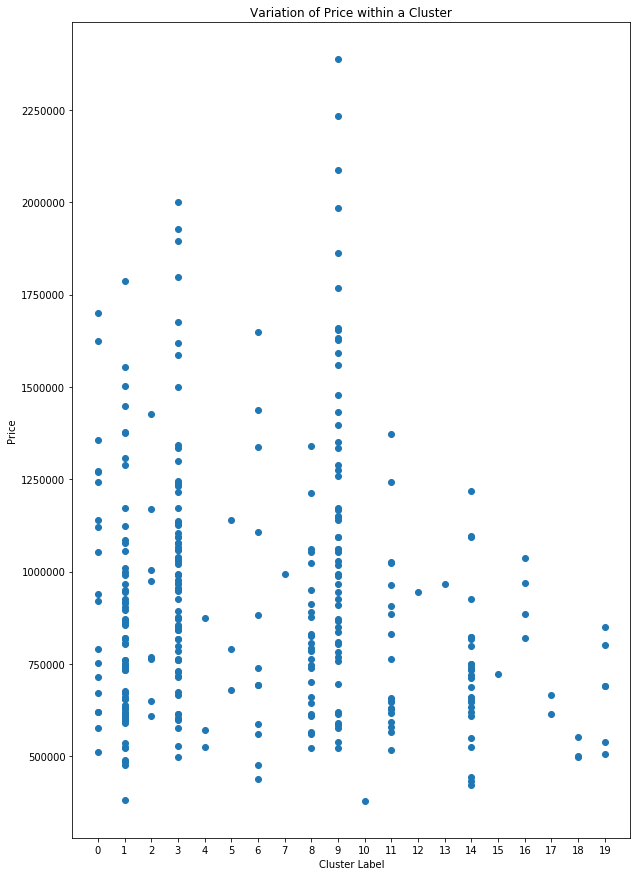

In [318]:
import matplotlib.pyplot as plt
xticks = list(range(20))
fig,ax = plt.subplots(1,1,figsize = (10,15))
ax.scatter(suburb_overall_df_visual['Cluster Labels'],suburb_overall_df_visual['Price'])
ax.set_ylabel('Price')
ax.set_xlabel('Cluster Label')
ax.set_title('Variation of Price within a Cluster')
#ax.set_xticklabels(xticks)
plt.xticks(xticks)
plt.show()

In [303]:
import matplotlib.cm as cm
import matplotlib.colors as colors

color_names = ['red', 'blue', 'green', 'purple', 'orange', 'darkred',
'lightred', 'beige', 'darkblue', 'darkgreen', 'cadetblue', 'darkpurple', 'white', 'pink', 'lightblue', 'lightgreen', 'gray', 'black', 'lightgray','cyan']


for suburb,cluster_label,lat,lng,price in zip(suburb_overall_df_visual['Suburb'],suburb_overall_df_visual['Cluster Labels'],suburb_overall_df_visual['Latitude'],suburb_overall_df_visual['Longitude'],suburb_overall_df_visual['Price']):
    label = '{},{},{}'.format(suburb,cluster_label,int(price))
    folium.CircleMarker([lat,lng],radius = 5, popup = label, color = color_names[cluster_label], fill=True,
        fill_color=color_names[cluster_label],
        fill_opacity=0.7,
        parse_html=False).add_to(melbourne_map_final)
melbourne_map_final

<h1> Conclusion </h1>

The above study has shown that towards Central Melbourne, the clusters are dominated by the Clusters with higher housing prices, namely Clusters 9 and 3. While these sames clusters are present in outer areas of central melbourne, we see that the less expensive Clusters tend to occur away from central Melbourne. Keeping in mind that these clusters were built based on the frequency of venue categories in it's vicinity, this tells us that a potential buyer who is looking for **roughly** the same facilities, however wants a house away from the hustle and bustle of the inner city,and infact pay an equal amount for the house may look for a suburb within the same cluster but away from the city or vice versa. 

Furthermore, as shown in the scatter plot **Variation of Price within a Cluster** the price of a house may vary within these clusters itself.

Hence a buyer who's looking for a house in a certain suburb, however the price is out of his/her price range may look to go to a suburb within that cluster of suburbs, which has a price that fits his/her range



